# Исследование рынка заведений общественного питания Москвы

Фонд «Shut Up and Take My Money» просит провести исследование рынка общественного питания Москвы, найти интересные закономерности и презентовать полученные результаты. 

Нам доступен датасет с заведениями общественного питания Москвы, составленный на основе данных сервисов Яндекс Карты и Яндекс Бизнес на лето 2022 года. Информация, размещённая в сервисе Яндекс Бизнес, могла быть добавлена пользователями или найдена в общедоступных источниках. Она носит исключительно справочный характер.

Проведение исследования будет проходить следующими этапами:
1) Предобработка данных;

2) Анализ данных;

3) Исследование открытия кофейни;

4) Подготовка презентации.

## Этап - Изучение общей информации

Импортируем используемые в работе библиотеки.

In [1]:
import pandas as pd
pd.set_option('display.max_columns', 30)
pd.set_option('display.float_format', '{:,.2f}'.format)
import warnings
warnings.filterwarnings('ignore')
from plotly import graph_objects as go
import matplotlib.pyplot as plt 
import seaborn as sns
from folium import Map, Choropleth
from folium import Map, Marker
from folium.plugins import MarkerCluster
import plotly.express as px
import numpy as np

Подгружаем датафрейм. Выводим общую информацию о нём.

In [2]:
df = pd.read_csv('/datasets/moscow_places.csv')
df.info()                                        

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [3]:
df.head(50)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,5.00,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,4.50,выше среднего,Средний счёт:1500–1600 ₽,"1,550.00",NaN,0,4.00
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.89,37.53,4.60,средние,Средний счёт:от 1000 ₽,"1,000.00",NaN,0,45.00
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.88,37.49,5.00,NaN,Цена чашки капучино:155–185 ₽,NaN,170.00,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.45,5.00,средние,Средний счёт:400–600 ₽,500.00,NaN,1,148.00
5,Sergio Pizza,пиццерия,"Москва, Ижорская улица, вл8Б",Северный административный округ,"ежедневно, 10:00–23:00",55.89,37.51,4.60,средние,NaN,NaN,NaN,0,NaN
6,Огни города,"бар,паб","Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.89,37.52,4.40,средние,Средний счёт:199 ₽,199.00,NaN,0,45.00
7,Mr. Уголёк,быстрое питание,"Москва, Клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.89,37.52,4.70,средние,Средний счёт:200–300 ₽,250.00,NaN,0,45.00
8,Donna Maria,ресторан,"Москва, Дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.54,4.80,средние,Средний счёт:от 500 ₽,500.00,NaN,0,79.00
9,Готика,кафе,"Москва, Ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.88,37.52,4.30,средние,Средний счёт:1000–1200 ₽,"1,100.00",NaN,0,65.00


На данном этапе мы уже можем сказать, что все типы данных верные, а также об отсутствии необходимости заполнения пропусков и возможности  объективно их заполнить.

Проверим на наличие дубликатов после небольшого преобразования двух столбцов.

## Этап - Предобработка данных

### Этап - поиск дубликатов

In [4]:
df['name'] = df['name'].str.strip()
df['address'] = df['address'].str.strip()

In [5]:
df['name'] = df['name'].str.lower()
df['address'] = df['address'].str.lower()

In [6]:
df.duplicated().sum() 

0

In [7]:
df[df.duplicated(['name', 'address'])] 

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
215,кафе,кафе,"москва, парк ангарские пруды",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.53,3.20,NaN,NaN,NaN,NaN,0,NaN
1511,more poke,ресторан,"москва, волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.81,37.50,4.20,NaN,NaN,NaN,NaN,1,188.00
2420,раковарня клешни и хвосты,"бар,паб","москва, проспект мира, 118",Северо-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–01:00; вс 12:00...",55.81,37.64,4.40,NaN,NaN,NaN,NaN,1,150.00
3109,хлеб да выпечка,кафе,"москва, ярцевская улица, 19",Западный административный округ,NaN,55.74,37.41,4.10,NaN,NaN,NaN,NaN,0,276.00


In [8]:
df.drop_duplicates(['name', 'address']) 
df = df.reset_index(drop=True)

Как видим, абсолютных дубликатов нет, а по адресу и названию есть, но всего 4 - значит можно было и не удалять. Выбрал эти два стобца, чтобы проверить дубль заведения по одному адресу. Далее добавим столбец с улицей "street" и круглосуточным режимом работы "is_24/7"

### Этап - добавление столбцов

In [9]:
df['street'] = df['address'].apply(lambda x: x.split(',')[1])
#df['street'] = df['address'].str.split(', ').str[1]

In [10]:
df.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,5.00,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,4.50,выше среднего,Средний счёт:1500–1600 ₽,"1,550.00",NaN,0,4.00,улица дыбенко
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.89,37.53,4.60,средние,Средний счёт:от 1000 ₽,"1,000.00",NaN,0,45.00,клязьминская улица
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.88,37.49,5.00,NaN,Цена чашки капучино:155–185 ₽,NaN,170.00,0,NaN,улица маршала федоренко
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.45,5.00,средние,Средний счёт:400–600 ₽,500.00,NaN,1,148.00,правобережная улица


In [11]:
def is_24_7(hours):
    if hours == 'круглосуточно':
        return True
    elif hours == 'ежедневно, круглосуточно':
        return True
    else:
        return False
    
df['is_24/7'] = df['hours'].apply(is_24_7) 
#data['hours'].str.contains('ежедневно, круглосуточно')

In [12]:
df.head(50)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,wowфли,кафе,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,5.00,NaN,NaN,NaN,NaN,0,NaN,улица дыбенко,False
1,четыре комнаты,ресторан,"москва, улица дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.48,4.50,выше среднего,Средний счёт:1500–1600 ₽,"1,550.00",NaN,0,4.00,улица дыбенко,False
2,хазри,кафе,"москва, клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.89,37.53,4.60,средние,Средний счёт:от 1000 ₽,"1,000.00",NaN,0,45.00,клязьминская улица,False
3,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.88,37.49,5.00,NaN,Цена чашки капучино:155–185 ₽,NaN,170.00,0,NaN,улица маршала федоренко,False
4,иль марко,пиццерия,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.45,5.00,средние,Средний счёт:400–600 ₽,500.00,NaN,1,148.00,правобережная улица,False
5,sergio pizza,пиццерия,"москва, ижорская улица, вл8б",Северный административный округ,"ежедневно, 10:00–23:00",55.89,37.51,4.60,средние,NaN,NaN,NaN,0,NaN,ижорская улица,False
6,огни города,"бар,паб","москва, клязьминская улица, 9, стр. 3",Северный административный округ,пн 15:00–04:00; вт-вс 15:00–05:00,55.89,37.52,4.40,средние,Средний счёт:199 ₽,199.00,NaN,0,45.00,клязьминская улица,False
7,mr. уголёк,быстрое питание,"москва, клязьминская улица, 9, стр. 3",Северный административный округ,"пн-чт 10:00–22:00; пт,сб 10:00–23:00; вс 10:00...",55.89,37.52,4.70,средние,Средний счёт:200–300 ₽,250.00,NaN,0,45.00,клязьминская улица,False
8,donna maria,ресторан,"москва, дмитровское шоссе, 107, корп. 4",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.54,4.80,средние,Средний счёт:от 500 ₽,500.00,NaN,0,79.00,дмитровское шоссе,False
9,готика,кафе,"москва, ангарская улица, 39",Северный административный округ,"ежедневно, 12:00–00:00",55.88,37.52,4.30,средние,Средний счёт:1000–1200 ₽,"1,100.00",NaN,0,65.00,ангарская улица,False


На этом этапе мы добавили два столбца:

1) 'street' - название улицы где раположено заведение

2) 'is_24/7' - обозначение круглосуточного режима работы заведения

## Этап - Анализ данных

### Поиск закономерностей

In [13]:
category_rest = df['category'].unique()
values = df['category'].value_counts()

fig = go.Figure(data=[go.Pie(labels=category_rest, values=values)])

fig.update_layout(title='Количество заведений по категориям',
                  width=800, 
                  height=600,
                  annotations=[dict(x=1.12,
                                    y=1.05,
                                    text='Категория',
                                    showarrow=False)])

fig.show() 

Построив круговую диаграмму отмечу, что наибольшее кол-во заведений приходится на кафе - 28.3%, на втором месте рестораны - 24.3%, не так далеко от первых двух мест кофейня - 16,8%, остальные 30,4% относятся к другим категориям.

In [14]:
total_seats = df.pivot_table(index = 'category',
                 values = 'seats', aggfunc = 'sum').sort_values('seats', ascending = False)

x = df['category'].unique()

fig = px.bar(total_seats.sort_values(by='seats', ascending=False),
             x = x,
             y = 'seats',
             text='seats'
            )

fig.update_layout(title='Количество посадочных мест по категориям',
                   xaxis_title='Категория',
                   yaxis_title='Посадочных мест')
fig.show()

Сгруппировав данные по категориям, посчитали как распределено кол-во мест по категориям, 1 место - рестораны с количеством мест в 154,869 единиц, 2 место - кафе с количеством мест в 118,770 единиц, 3 место кофейни с количеством мест в 83,511 единиц.

In [15]:
chain_or_not = df.pivot_table(index = 'chain',
                 values = 'name', aggfunc = 'count')

x = df['chain'].unique()

fig = px.bar(chain_or_not.sort_values(by='name', ascending=False),
             x = x,
             y = 'name',
             text='name'
            )

fig.update_layout(title='Количество сетевых и одиночных заведений',
                   xaxis_title='сетевое или одиночное',
                   yaxis_title='Количество')

fig.show()

Сетевых заведений 3205, а несетевых 5201.

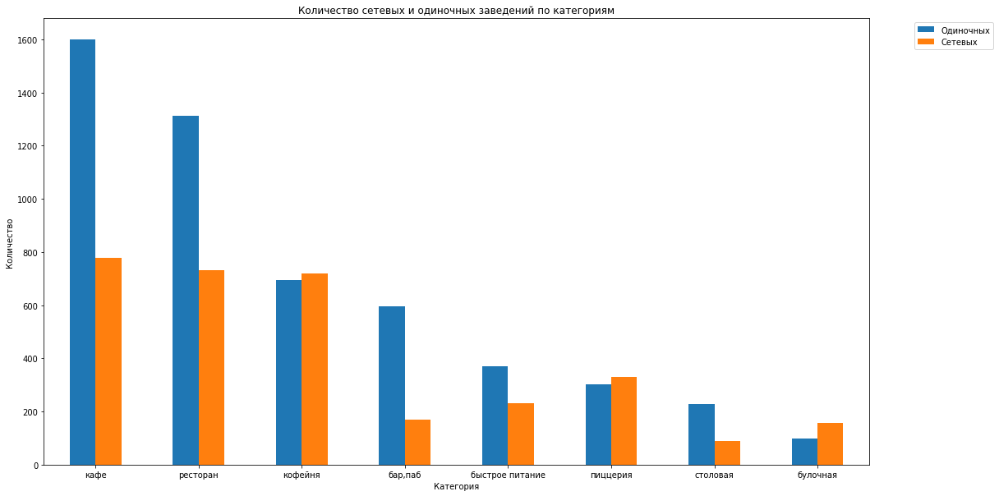

                 Одиночных  Сетевых  Доля сетевых
category                                         
булочная                99      157          0.61
пиццерия               303      330          0.52
кофейня                693      720          0.51
быстрое питание        371      232          0.38
ресторан              1313      730          0.36
кафе                  1599      779          0.33
столовая               227       88          0.28
бар,паб                596      169          0.22


In [46]:
stat_chain1 = df.pivot_table(index = 'category',
                 columns = 'chain',
                 values = 'name', aggfunc = 'count')

stat_chain1.columns = ['Одиночных', 'Сетевых']

stat_chain1.sort_values('Одиночных', ascending = False).plot(figsize = (18, 10), kind = 'bar', rot = 0)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Количество сетевых и одиночных заведений по категориям')
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.show()

stat_chain1['Доля сетевых'] = stat_chain1['Сетевых']/(stat_chain1['Одиночных']+stat_chain1['Сетевых'])
print(stat_chain1.sort_values('Доля сетевых', ascending = False))

Несетевых заведений на 62% больше сетевых. Сетевыми заведениями чаще всех являются кафе, кофейни и рестораны. Интереснее факт - в каких категориях сетевых заведений больше одиночных: 1) булочные на 59% 2) пиццерии на 9% 3) кофейни на 4%

In [17]:
stat_chain2 = df.pivot_table(index = 'name',
                 values='category', aggfunc=['first', 'count'])

stat_chain2.columns = ['category', 'count']

stat_chain2 = stat_chain2.sort_values('count', ascending = False).head(15)

x = ['кафе', 'шоколадница', "домино`с пицца", 'додо пицца', 'one price coffee', 'яндекс лавка', 'cofix', 'prime', 'хинкальная',
'шаурма', 'кофепорт', 'кулинарная лавка братьев караваевых', 'теремок', 'чайхана', 'ресторан']

fig = px.bar(stat_chain2,
             x = x,
             y = 'count',
             color = stat_chain2['category'],
             text='count'
            )

fig.update_layout(title='Топ-15 сетевых заведений по категориям',
                  xaxis_title='Название заведения',
                  yaxis_title='Количество')

fig.show()

stat_chain2

,category,count
name,,
кафе,кафе,189
шоколадница,кофейня,120
домино'с пицца,пиццерия,77
додо пицца,пиццерия,74
one price coffee,кофейня,72
яндекс лавка,ресторан,69
cofix,кофейня,65
prime,ресторан,50
хинкальная,быстрое питание,44


Самая крупная сеть "Кафе" - 189 заведений, на втором месте "Шоколадница" - 120 заведений, на третьем с небольшим отрывом от следующих "Домино'с пицца" - 77 заведений.

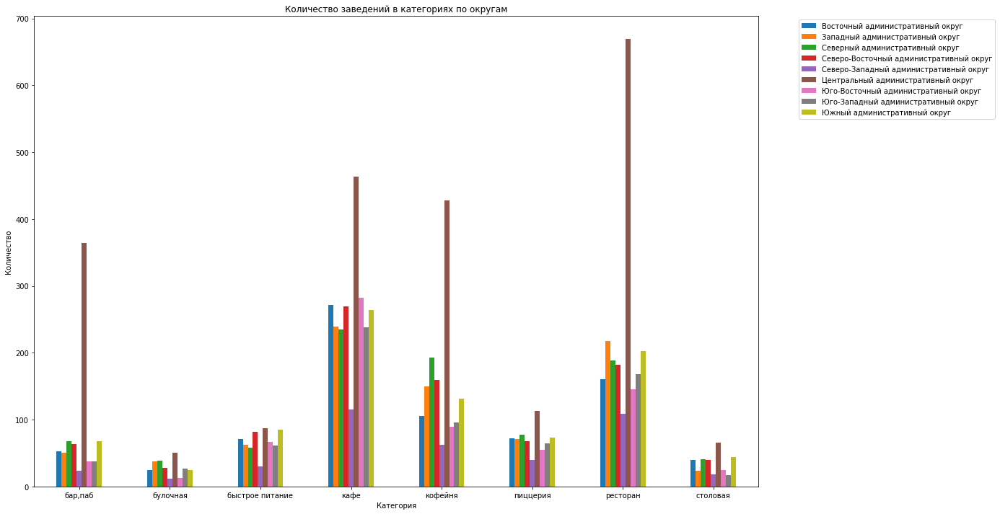

district
Восточный административный округ            798
Западный административный округ             851
Северный административный округ             900
Северо-Восточный административный округ     891
Северо-Западный административный округ      409
Центральный административный округ         2242
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Южный административный округ                892
dtype: int64 district
Восточный административный округ          0.09
Западный административный округ           0.10
Северный административный округ           0.11
Северо-Восточный административный округ   0.11
Северо-Западный административный округ    0.05
Центральный административный округ        0.27
Юго-Восточный административный округ      0.08
Юго-Западный административный округ       0.08
Южный административный округ              0.11
dtype: float64


district,Восточный административный округ,Западный административный округ,Северный административный округ,Северо-Восточный административный округ,Северо-Западный административный округ,Центральный административный округ,Юго-Восточный административный округ,Юго-Западный административный округ,Южный административный округ
category,,,,,,,,,
кафе,272,239,235,269,115,464,282,238,264
ресторан,160,218,189,182,109,670,145,168,202
кофейня,105,150,193,159,62,428,89,96,131
пиццерия,72,71,77,68,40,113,55,64,73
быстрое питание,71,62,58,82,30,87,67,61,85
"бар,паб",53,50,68,63,23,364,38,38,68
столовая,40,24,41,40,18,66,25,17,44
булочная,25,37,39,28,12,50,13,27,25


In [47]:
stat_district = df.pivot_table(index = 'category',
                 columns = 'district',
                 values = 'name', aggfunc = 'count')

stat_district.plot(figsize = (18, 12), kind = 'bar', rot = 0)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Количество заведений в категориях по округам')
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.show()

print(stat_district.sum(), stat_district.sum()/stat_district.sum().sum())

stat_district.sort_values('Восточный административный округ', ascending = False)

Центральный административный округ сильно опережает другие районы по количеству заведений - его доля от общего количества 27%. Меньше всего заведений в Северо-Западном административном округе - 5% .

In [51]:
def plot_bar(df, x, y, text, title, xaxis_title, yaxis_title):
    fig = px.bar(
        category_rating,
        x=x,
        y=y,
        text=text,
    )

    fig.update_layout(
        title=title,
        xaxis_title=xaxis_title,
        yaxis_title=yaxis_title,
    )

    fig.show()

In [52]:
category_rating = df.pivot_table(index = 'category', values = 'rating', aggfunc = 'mean').sort_values('rating', ascending = False)

category_rating['rating'] = np.round(category_rating['rating'], 2)

x = df['category'].unique()

plot_bar(
    df=category_rating,
    x=df['category'].unique(),
    y='rating',
    text='rating',
    title='Рейтинг',
    xaxis_title='Категория',
    yaxis_title='Баллы',
)

Разница в среднем рейтинге категорий заведений незначительна.

In [22]:
rating_district = df.groupby('district', as_index=False)['rating'].agg('median')

In [23]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

Choropleth(
    geo_data=state_geo,
    data=rating_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m)

display(m)

rating_district

,district,rating
0,Восточный административный округ,4.30
1,Западный административный округ,4.30
2,Северный административный округ,4.30
3,Северо-Восточный административный округ,4.20
4,Северо-Западный административный округ,4.30
5,Центральный административный округ,4.40
6,Юго-Восточный административный округ,4.20
7,Юго-Западный административный округ,4.30
8,Южный административный округ,4.30


На карте отображен средний рейтинг районов Москвы и кластерами обозначены заведения внутри каждого района. Самый высокий средний рейтинг в центральном районе Москвы - 4,4 балла. Самый низкий средний рейтинг в Северно-Восточном и Юго-Восточном районах Москвы 4,2 балла.

In [24]:
street_rating1 = (
    df.groupby('street', as_index=False)['name'].agg('count')
    .sort_values('name', ascending = False)
    .head(15).reset_index(drop=True)
)

fig = px.bar(street_rating1,
             x = 'street',
             y = 'name',
             text='name'
            )

fig.update_layout(title='Топ-15 улиц по количеству заведений на них',
                   xaxis_title='Улица',
                   yaxis_title='Количество')

fig.show()

In [25]:
street_rating_df = df.query('street in @street_rating1.street').reset_index(drop=True) #отбираем из основного ДФ данные по топ-15 улиц 

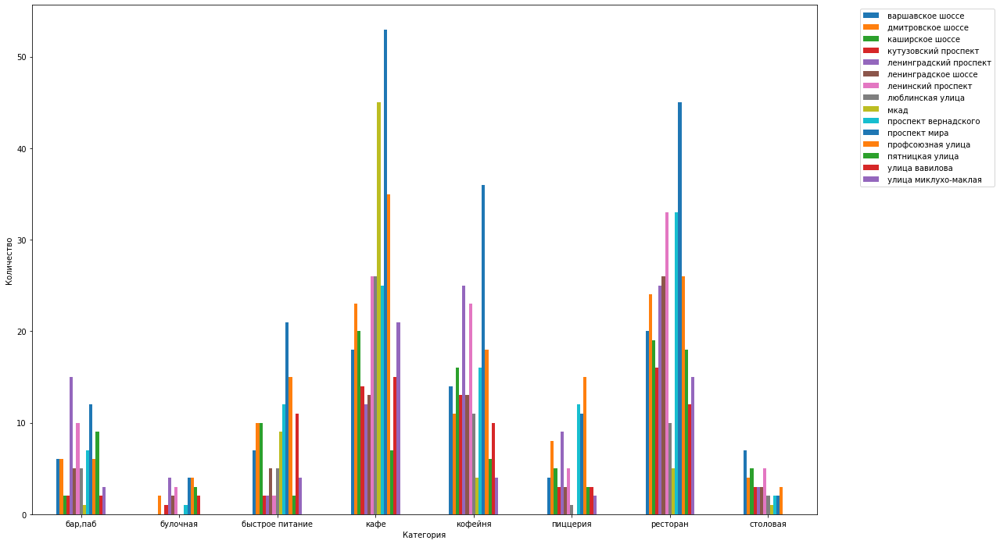

street,варшавское шоссе,дмитровское шоссе,каширское шоссе,кутузовский проспект,ленинградский проспект,ленинградское шоссе,ленинский проспект,люблинская улица,мкад,проспект вернадского,проспект мира,профсоюзная улица,пятницкая улица,улица вавилова,улица миклухо-маклая
category,,,,,,,,,,,,,,,
"бар,паб",6.00,6.00,2.00,2.00,15.00,5.00,10.00,5.00,1.00,7.00,12.00,6.00,9.00,2.00,3.00
булочная,NaN,2.00,NaN,1.00,4.00,2.00,3.00,NaN,NaN,1.00,4.00,4.00,3.00,2.00,NaN
быстрое питание,7.00,10.00,10.00,2.00,2.00,5.00,2.00,5.00,9.00,12.00,21.00,15.00,2.00,11.00,4.00
кафе,18.00,23.00,20.00,14.00,12.00,13.00,26.00,26.00,45.00,25.00,53.00,35.00,7.00,15.00,21.00
кофейня,14.00,11.00,16.00,13.00,25.00,13.00,23.00,11.00,4.00,16.00,36.00,18.00,6.00,10.00,4.00
пиццерия,4.00,8.00,5.00,3.00,9.00,3.00,5.00,1.00,NaN,12.00,11.00,15.00,3.00,3.00,2.00
ресторан,20.00,24.00,19.00,16.00,25.00,26.00,33.00,10.00,5.00,33.00,45.00,26.00,18.00,12.00,15.00
столовая,7.00,4.00,5.00,3.00,3.00,3.00,5.00,2.00,1.00,2.00,2.00,3.00,NaN,NaN,NaN


In [26]:
df_top_street = street_rating_df.pivot_table(index = 'category', columns = 'street', values = 'name', aggfunc = 'count')

df_top_street.plot(figsize = (18, 12), kind = 'bar', rot = 0)
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title('Рейтинг заведений в категориях по округам')
plt.xlabel('Категория')
plt.ylabel('Количество')
plt.show()

df_top_street

Построив столбчатую диаграмму и сводную таблицу можно увидеть, что на проспекте мира находится большая часть заведений - 184, на втором месте профсоюзная улица - 122 заведения, на третьем и четвёртом с кол-вом 107 и 108 заведений расположились проспект Вернадского и Ленинский проспект соответственно.

In [27]:
street_stat = df.groupby('street', as_index=False)['name'].agg('count').sort_values('name', ascending = False)

street_stat = street_stat.query('name == 1')

street_stat_df = df.query('street in @street_stat.street').reset_index(drop=True)

street_stat_df

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,дом обеда,столовая,"москва, улица бусиновская горка, 2",Северный административный округ,пн-пт 08:30–18:30; сб 10:00–20:00,55.89,37.49,4.10,средние,Средний счёт:300–500 ₽,400.00,NaN,0,180.00,улица бусиновская горка,False
1,7/12,кафе,"москва, прибрежный проезд, 7",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.46,4.50,NaN,NaN,NaN,NaN,0,NaN,прибрежный проезд,False
2,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.88,37.46,4.30,NaN,NaN,NaN,NaN,1,NaN,парк левобережный,False
3,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.90,37.57,4.10,средние,Средний счёт:500–800 ₽,650.00,NaN,1,NaN,угличская улица,False
4,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.90,37.57,4.90,NaN,NaN,NaN,NaN,1,NaN,ландшафтный заказник лианозовский,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
452,мираж,ресторан,"москва, улица шкулёва, 2а",Юго-Восточный административный округ,"пн-пт 11:00–23:00; сб,вс 11:00–00:00",55.69,37.75,4.70,NaN,NaN,NaN,NaN,0,90.00,улица шкулёва,False
453,wtfcoffee,кофейня,"москва, улица артюхиной, 14/8с1",Юго-Восточный административный округ,"ежедневно, 10:00–22:00",55.70,37.74,4.40,средние,NaN,NaN,NaN,0,NaN,улица артюхиной,False
454,беседка,кафе,"москва, кузьминская улица, 10",Юго-Восточный административный округ,"ежедневно, 11:00–23:00",55.69,37.79,4.10,NaN,NaN,NaN,NaN,1,NaN,кузьминская улица,False
455,лагман хаус,кафе,"москва, новороссийская улица, 14, стр. 2",Юго-Восточный административный округ,"ежедневно, 10:00–00:00",55.68,37.76,4.30,NaN,NaN,NaN,NaN,1,40.00,новороссийская улица,False


Всего 457 улиц с 1 заведением на них.

In [28]:
tail_street_rating = street_stat_df.groupby('category', as_index=False)['rating'].agg('median')
tail_street_rating

,category,rating
0,"бар,паб",4.50
1,булочная,4.35
2,быстрое питание,4.30
3,кафе,4.20
4,кофейня,4.30
5,пиццерия,4.30
6,ресторан,4.30
7,столовая,4.30


In [29]:
tail_street_rating = street_stat_df.groupby('category', as_index=False)['name'].agg('count').sort_values('name', ascending = False).reset_index(drop=True)
tail_street_rating 

,category,name
0,кафе,159
1,ресторан,93
2,кофейня,84
3,"бар,паб",39
4,столовая,36
5,быстрое питание,23
6,пиццерия,15
7,булочная,8


In [30]:
tail_street_rating = street_stat_df.groupby('category', as_index=False)['middle_avg_bill'].agg('mean').sort_values('middle_avg_bill', ascending = False).reset_index(drop=True)
tail_street_rating 

,category,middle_avg_bill
0,ресторан,"1,707.14"
1,"бар,паб","1,458.33"
2,пиццерия,785.50
3,быстрое питание,680.56
4,кафе,654.31
5,кофейня,568.33
6,столовая,283.04
7,булочная,NaN


In [31]:
df_avg_bill = df.groupby('category', as_index=False)['middle_avg_bill'].agg('mean').sort_values('middle_avg_bill', ascending = False).reset_index(drop=True)
df_avg_bill 

,category,middle_avg_bill
0,ресторан,"1,367.88"
1,"бар,паб","1,338.76"
2,пиццерия,789.38
3,кафе,707.75
4,булочная,658.77
5,кофейня,614.21
6,быстрое питание,445.76
7,столовая,335.35


Проверил отличается ли рейтинг и распределения категорий единственных на улице заведений, нельзя назвать явное отличие, только, что столовых больше, чем пиццерий. 

Интереснее становится при сравнении средних чеков заведений в единственном кол-ве на улице со средним чеком по всему ДФ, сгруппированных по категориям. Сильно выделяются рестораны и заведения быстрого питания. В случае с медианной разница не так значительна.

In [32]:
district_avg_bill = df.groupby('district')['middle_avg_bill'].agg('median')

In [33]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

Choropleth(
    geo_data=state_geo,
    data=district_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек заведений по районам',
).add_to(m)

display(m)

district_avg_bill

district
Восточный административный округ            575.00
Западный административный округ           1,000.00
Северный административный округ             650.00
Северо-Восточный административный округ     500.00
Северо-Западный административный округ      700.00
Центральный административный округ        1,000.00
Юго-Восточный административный округ        450.00
Юго-Западный административный округ         600.00
Южный административный округ                500.00
Name: middle_avg_bill, dtype: float64

Как можем наблюдать по карте, нельзя точно сказать, как удалённость от центра влияет на цены в заведениях. Скорее тут исторические факторы, какие люди живут в каких районах города, а также насколька развитая инфраструктура в данных районах.

In [34]:
district_density = df.groupby('district')['rating'].count()

In [35]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

Choropleth(
    geo_data=state_geo,
    data=district_density,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество заведений по округам',
).add_to(m)

display(m)

district_density

district
Восточный административный округ            798
Западный административный округ             851
Северный административный округ             900
Северо-Восточный административный округ     891
Северо-Западный административный округ      409
Центральный административный округ         2242
Юго-Восточный административный округ        714
Юго-Западный административный округ         709
Южный административный округ                892
Name: rating, dtype: int64

### Общий вывод этапа

Построив круговую диаграмму отмечу, что наибольшее кол-во заведений приходится на кафе - 28.3%, на втором месте рестораны - 24.3%, не так далеко от первых двух мест кофейня - 16,8%, остальные 30,4% относятся к другим категориям.

Сгруппировав данные по категориям, посчитали как распределено кол-во мест по категориям, 1 место - рестораны с количеством мест в 154,869 единиц, 2 место - кафе с количеством мест в 118,770 единиц, 3 место кофейни с количеством мест в 83,511 единиц.

Сетевых заведение 3205, а несетевых 5201.

Несетевых заведений на 62% больше сетевых. Сетевыми заведениями чаще всех являются кафе, кофейни и рестораны. Интереснее факт - в каких категориях сетевых заведений больше одиночных: 1) булочные на 59% 2) пиццерии на 9% 3) кофейни на 4%

Самая крупная сеть "Кафе" - 189 заведений, на втором месте "Шоколадница" - 120 заведений, на третьем с небольшим отрывом от следующих "Домино'с пицца" - 77 заведений.

Центральный административный округ сильно опережает другие районы по количеству заведений - его доля от общего количества 27%. Меньше всего заведений в Северо-Западном административном округе - 5% .

Разница в среднем рейтинге категорий заведений незначительна.

Самый высокий средний рейтинг в центральном районе Москвы - 4,4 балла. Самый низкий средний рейтинг в Северно-Восточном и Юго-Восточном районах Москвы 4,2 балла.

На проспекте мира находится большая часть заведений - 184, на втором месте профсоюзная улица - 122 заведения, на третьем и четвёртом с кол-вом 107 и 108 заведений расположились проспект Вернадского и Ленинский проспект соответственно.

Всего 457 улиц с 1 заведением на них.

Проверил отличается ли рейтинг и распределения категорий единственных на улице заведений, нельзя назвать явное отличие, только, что столовых больше, чем пиццерий.

Интереснее становится при сравнении средних чеков заведений в единственном кол-ве на улице со средним чеком по всему ДФ, сгруппированных по категориям. Сильно выделяются рестораны и заведения быстрого питания. В случае с медианной результат не так интересен.

Нельзя точно сказать, как удалённость от центра влияет на цены в заведениях. Скорее тут исторические факторы, какие люди живут в каких районах города, а также насколька развитая инфраструктура в данных районах.

## Открытие кофейни

### Исследование рынка кофеен Москвы

In [36]:
df_coffee = df.query('category == "кофейня"').reset_index(drop=True)
df_coffee.info()
df_coffee.head(20)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1413 entries, 0 to 1412
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               1413 non-null   object 
 1   category           1413 non-null   object 
 2   address            1413 non-null   object 
 3   district           1413 non-null   object 
 4   hours              1398 non-null   object 
 5   lat                1413 non-null   float64
 6   lng                1413 non-null   float64
 7   rating             1413 non-null   float64
 8   price              476 non-null    object 
 9   avg_bill           721 non-null    object 
 10  middle_avg_bill    200 non-null    float64
 11  middle_coffee_cup  521 non-null    float64
 12  chain              1413 non-null   int64  
 13  seats              751 non-null    float64
 14  street             1413 non-null   object 
 15  is_24/7            1413 non-null   bool   
dtypes: bool(1), float64(6), 

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
0,dormouse coffee shop,кофейня,"москва, улица маршала федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.88,37.49,5.00,NaN,Цена чашки капучино:155–185 ₽,NaN,170.00,0,NaN,улица маршала федоренко,False
1,в парке вкуснее,кофейня,"москва, парк левобережный",Северный административный округ,"ежедневно, 10:00–21:00",55.88,37.46,4.30,NaN,NaN,NaN,NaN,1,NaN,парк левобережный,False
2,9 bar coffee,кофейня,"москва, коровинское шоссе, 41, стр. 1",Северный административный округ,пн-пт 08:00–18:00,55.89,37.51,4.00,NaN,NaN,NaN,NaN,1,46.00,коровинское шоссе,False
3,cofefest,кофейня,"москва, улица маршала федоренко, 6с1",Северный административный округ,пн-пт 09:00–19:00,55.88,37.49,3.60,NaN,NaN,NaN,NaN,1,NaN,улица маршала федоренко,False
4,cofix,кофейня,"москва, улица дыбенко, 7/1",Северный административный округ,"ежедневно, 08:00–22:00",55.88,37.48,3.80,NaN,NaN,NaN,NaN,1,NaN,улица дыбенко,False
5,royal coffee,кофейня,"москва, правобережная улица, 1б",Северный административный округ,"ежедневно, 10:00–22:00",55.88,37.45,3.10,NaN,NaN,NaN,NaN,0,148.00,правобережная улица,False
6,coffeekaldi's,кофейня,"москва, угличская улица, 13, стр. 8",Северо-Восточный административный округ,"ежедневно, 09:00–22:00",55.90,37.57,4.10,средние,Средний счёт:500–800 ₽,650.00,NaN,1,NaN,угличская улица,False
7,чебуречная история,кофейня,"москва, ландшафтный заказник лианозовский",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.90,37.57,4.90,NaN,NaN,NaN,NaN,1,NaN,ландшафтный заказник лианозовский,False
8,testo мания,кофейня,"москва, лианозовский парк культуры и отдыха",Северо-Восточный административный округ,"ежедневно, 09:00–21:00",55.90,37.57,4.10,NaN,NaN,NaN,NaN,0,NaN,лианозовский парк культуры и отдыха,False
9,молинари,кофейня,"москва, алтуфьевское шоссе, 70, корп. 1",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.89,37.59,4.80,NaN,NaN,NaN,NaN,0,120.00,алтуфьевское шоссе,False


Получаем кофейный ДФ размером в 1413 строк.

In [37]:
df_coffee.groupby('is_24/7')['name'].count()

is_24/7
False    1354
True       59
Name: name, dtype: int64

Сетевых кофеен 59 шт.

In [38]:
coffee_rate = df_coffee.groupby('district')['rating'].mean()

In [39]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

Choropleth(
    geo_data=state_geo,
    data=coffee_rate,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

display(m)

coffee_rate

district
Восточный административный округ          4.28
Западный административный округ           4.20
Северный административный округ           4.29
Северо-Восточный административный округ   4.22
Северо-Западный административный округ    4.33
Центральный административный округ        4.34
Юго-Восточный административный округ      4.23
Юго-Западный административный округ       4.28
Южный административный округ              4.23
Name: rating, dtype: float64

Самые высокие рейтинги в Центральный административный округ и Северо-Западный административный округ - значит там высокий уровень сервиса. Самые низкие показатели рейтинга в Западный административный округ, Северо-Восточный административный округ,  Юго-Восточный административный округ и Южный административный округ - значит в этих районах можно создать кофейню с хорошим уровнем сервиса.

In [40]:
coffee_density = df_coffee.groupby('district')['rating'].count()

In [41]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

Choropleth(
    geo_data=state_geo,
    data=coffee_density,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Количество заведений по районам',
).add_to(m)

display(m)

coffee_density

district
Восточный административный округ           105
Западный административный округ            150
Северный административный округ            193
Северо-Восточный административный округ    159
Северо-Западный административный округ      62
Центральный административный округ         428
Юго-Восточный административный округ        89
Юго-Западный административный округ         96
Южный административный округ               131
Name: rating, dtype: int64

In [42]:
coffee_density.mean()

157.0

Нас интересуют районы с количеством заведений меньше 160, а это все, кроме - Северный административный округ и Центральный административный округ.

In [43]:
coffee_avg_bill = df_coffee.groupby('district')['middle_avg_bill'].mean()

In [44]:
state_geo = '/datasets/admin_level_geomap.geojson'

moscow_lat, moscow_lng = 55.751244, 37.618423

m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

marker_cluster = MarkerCluster().add_to(m)

def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['middle_avg_bill']}",
    ).add_to(marker_cluster)

df.apply(create_clusters, axis=1)

Choropleth(
    geo_data=state_geo,
    data=coffee_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='Средний чек заведений по районам',
).add_to(m)

display(m)

coffee_avg_bill

district
Восточный административный округ          486.11
Западный административный округ           694.44
Северный административный округ           495.74
Северо-Восточный административный округ   433.16
Северо-Западный административный округ    440.64
Центральный административный округ        794.76
Юго-Восточный административный округ      263.00
Юго-Западный административный округ       381.82
Южный административный округ              504.78
Name: middle_avg_bill, dtype: float64

In [45]:
coffee_avg_bill.mean()

499.3830357235929

Нас интересуют районы со средним чеком выше среднего - 499 и попали в предыдущий отбор по уровню сервиса и кол-ву заведений на округ, а это Западный административный округ и Южный административный округ.

### Вывод по исследованию рынка кофеен Москвы

В Москве всего 1413 кофеен из которых 59 - сетевые. 

Сначала посмотрим на средний рейтинг кофеен по округам г. Москвы. Самые высокие рейтинги в Центральном административном округе 4.34 и Северо-Западном административном округе 4.33 - значит там высокий уровень сервиса. Самые низкие показатели рейтинга в Западном административном округе 4.20, Северо-Восточном административном округе 4.22,  Юго-Восточном административном округе 4.23 и Южном административном округе 4.23- значит в этих районах можно создать кофейню с хорошим уровнем сервиса.

Далее посмотрим на заполненность округов кофейнями и выясняем, что Центральный административный округ- 428 кофеен, переполнен, а на втором месте Северный административный округ - 193 кофейни, имеет показатель выше среднего, поэтому с сомнением смотрим на этот вариант. Самые низкие показатели 62, 89 и 96 в Северо-Западном административном округе, Юго-Восточном административном округе и Юго-Западном административном округе соответственно. А в Западном административном округе и Южном административном округе, которые мы отобрали по рейтингу, как самые интересные с точки зрения уровня сервиса - 150 и 131 заведение, что попадает в норму. 

Чтобы сделать окончательный выбор округа - посмотрим на средний чек, ведь нам интересна аудитория, которая готова платить больше. Сильно выбиваются из колеи, в хорошем смысле, Центральный административный округ - 794,76 р. и Западный административный округ - 694,44 р., который нас и интересует. Вспомним и про Южный район - 504,78 р., что на верхней границе среднего.

В итоге, можно сказать, что стоит выбирать между Южным и Западным административным округом, но лично я выбрал бы западный, потому что там 2 по рейтингу средний чек, самые низкие рейтинги и нет переполненности кофейнями.

## - [Презентация](https://drive.google.com/file/d/1UGsZdi4loG1t2wI9YfO1bGr8Yf5gNhqV/view?usp=share_link)